In [1]:
import torch
import torchvision.datasets as dset
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image
import cv2
import random

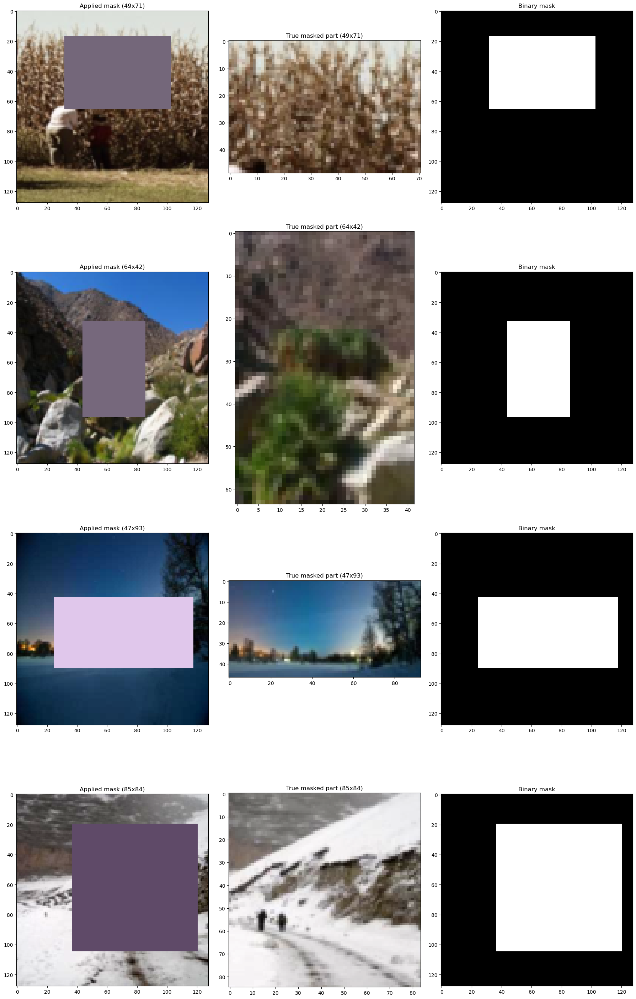

In [2]:
# Thông số
image_size = 128
min_mask_size = 32  # Kích thước nhỏ nhất của mặt nạ
max_mask_size = 96  # Kích thước lớn nhất của mặt nạ

# Load dataset
dataset = dset.ImageFolder(root='C:/Users/minhk/Downloads/Do_An_Computer_Vision/image_examples',
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Tạo plot
fig, ax = plt.subplots(4, 3, figsize=(18, 30))  # Thêm một cột cho ảnh mặt nạ nhị phân

# Thư mục để lưu ảnh mặt nạ
mask_save_dir = "C:/Users/minhk/Downloads/Do_An_Computer_Vision/binary_masks"
os.makedirs(mask_save_dir, exist_ok=True)

# Hiển thị 4 ảnh đầu
for i in range(4):
    orig_im, label = dataset[i]
    orig_im = orig_im.clone()  # Clone để không thay đổi dữ liệu gốc
    
    # Chọn kích thước ngẫu nhiên cho mặt nạ
    mask_h = random.randint(min_mask_size, min(max_mask_size, image_size))
    mask_w = random.randint(min_mask_size, min(max_mask_size, image_size))
    
    # Chọn vị trí top-left ngẫu nhiên cho mask
    top = random.randint(0, image_size - mask_h)
    left = random.randint(0, image_size - mask_w)
    
    # Lưu vùng bị mask (ground truth)
    true_masked_part = orig_im[:, top:top+mask_h, left:left+mask_w].clone()
    
    # Hiển thị vùng bị che (true masked part)
    part_disp = true_masked_part.clone()
    part_disp -= part_disp.min()
    part_disp /= part_disp.max()
    ax[i][1].imshow(part_disp.permute(1, 2, 0))
    ax[i][1].set_title(f'True masked part ({mask_h}x{mask_w})')
    
    # Áp dụng mặt nạ (giá trị mean RGB chuẩn hóa)
    orig_im[0, top:top+mask_h, left:left+mask_w] = (2 * 117.0 / 255.0 - 1.0)
    orig_im[1, top:top+mask_h, left:left+mask_w] = (2 * 104.0 / 255.0 - 1.0)
    orig_im[2, top:top+mask_h, left:left+mask_w] = (2 * 123.0 / 255.0 - 1.0)
    
    # Hiển thị ảnh đã che
    masked_disp = orig_im.clone()
    masked_disp -= masked_disp.min()
    masked_disp /= masked_disp.max()
    ax[i][0].imshow(masked_disp.permute(1, 2, 0))
    ax[i][0].set_title(f'Applied mask ({mask_h}x{mask_w})')
    
    # Tạo ảnh mặt nạ nhị phân (0 cho vùng không che, 1 cho vùng bị che)
    binary_mask = torch.zeros((1, image_size, image_size), dtype=torch.float)
    binary_mask[0, top:top+mask_h, left:left+mask_w] = 1.0
    
    # Hiển thị ảnh mặt nạ nhị phân
    ax[i][2].imshow(binary_mask[0], cmap='gray')
    ax[i][2].set_title('Binary mask')
    
    # Lưu ảnh mặt nạ nhị phân
    binary_mask_np = binary_mask[0].numpy() * 255  # Chuyển về [0, 255]
    binary_mask_img = Image.fromarray(binary_mask_np.astype('uint8'), mode='L')
    binary_mask_img.save(f"{mask_save_dir}/mask_{i}_{mask_h}x{mask_w}.png")

plt.tight_layout()
plt.show()

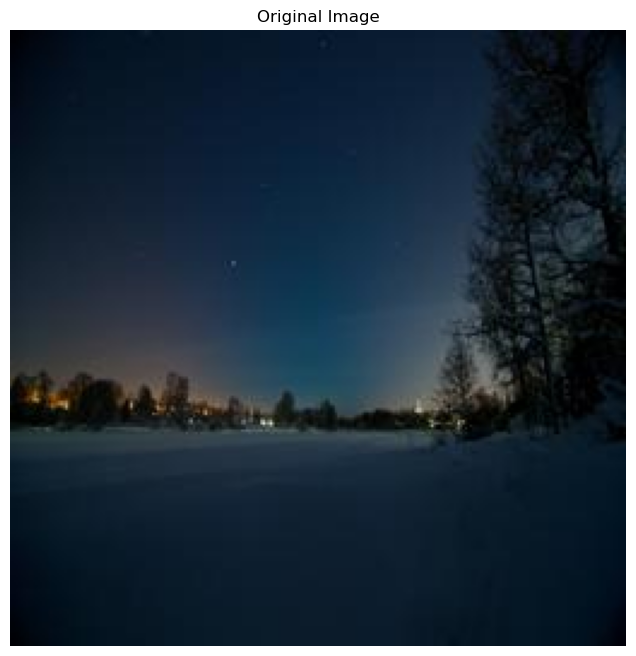

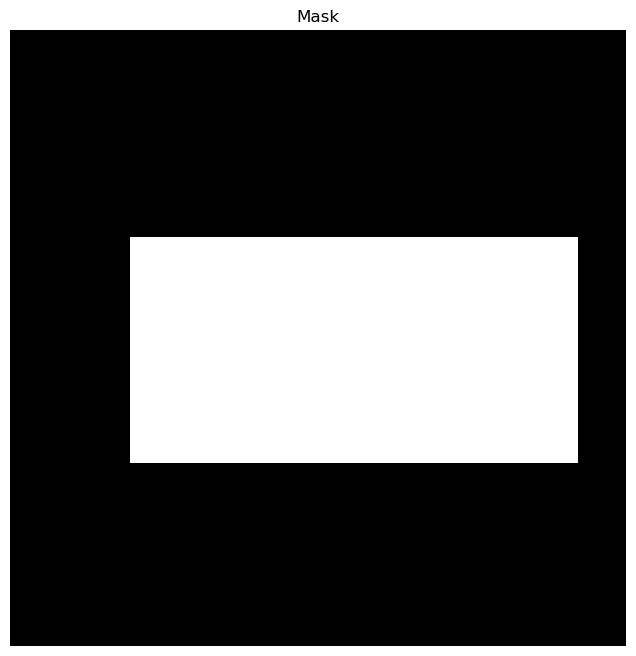

In [3]:
#1
original_img1 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/image_examples/sky/00000001.jpg')
mask1 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/binary_masks/mask_2_47x93.png', 0)

# Hiển thị ảnh gốc (chuyển từ BGR sang RGB vì OpenCV đọc ảnh dạng BGR)
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(original_img1, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')
plt.show()

# Hiển thị ảnh mask
plt.figure(figsize=(10, 8))
plt.imshow(mask1, cmap='gray')
plt.title('Mask')
plt.axis('off')
plt.show()

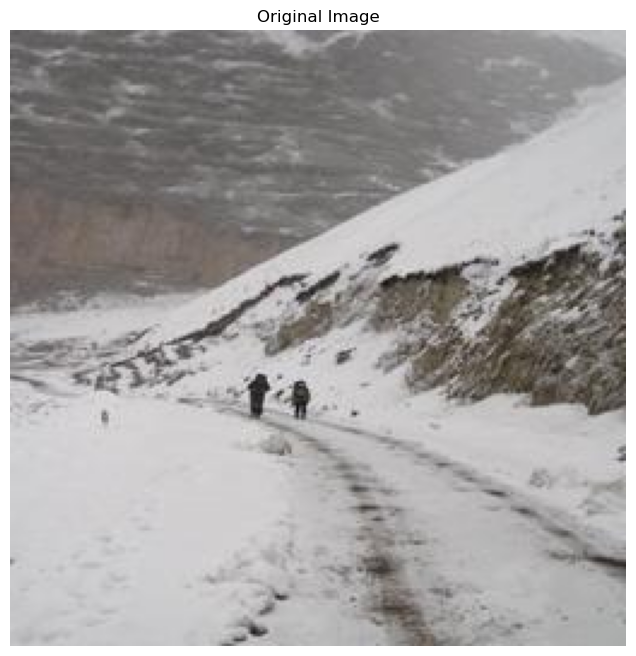

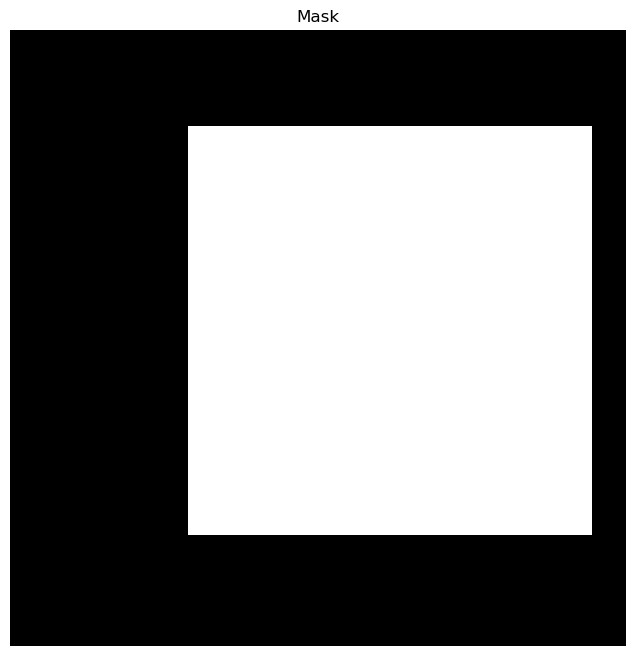

In [4]:
#2
original_img2 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/image_examples/snowfield/00000002.jpg')
mask2 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/binary_masks/mask_3_85x84.png', 0)

# Hiển thị ảnh gốc (chuyển từ BGR sang RGB vì OpenCV đọc ảnh dạng BGR)
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(original_img2, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')
plt.show()

# Hiển thị ảnh mask
plt.figure(figsize=(10, 8))
plt.imshow(mask2, cmap='gray')
plt.title('Mask')
plt.axis('off')
plt.show()

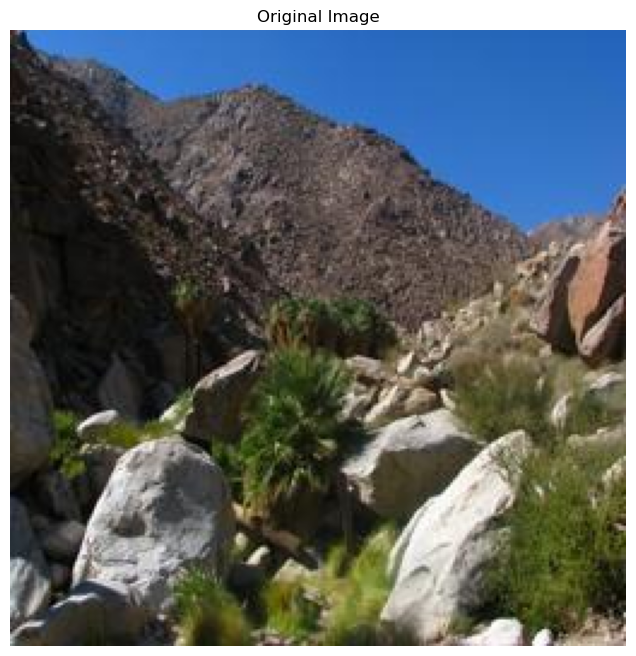

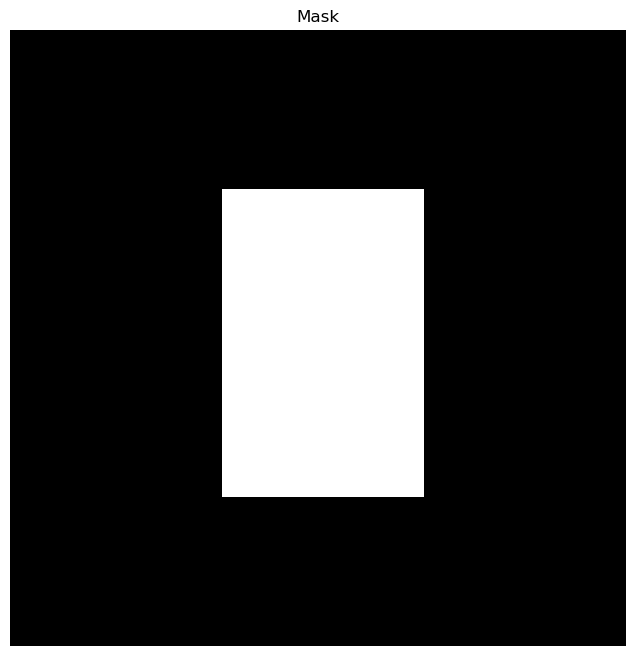

In [5]:
#3
original_img3 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/image_examples/mountain/00000003.jpg')
mask3 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/binary_masks/mask_1_64x42.png', 0)

# Hiển thị ảnh gốc (chuyển từ BGR sang RGB vì OpenCV đọc ảnh dạng BGR)
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(original_img3, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')
plt.show()

# Hiển thị ảnh mask
plt.figure(figsize=(10, 8))
plt.imshow(mask3, cmap='gray')
plt.title('Mask')
plt.axis('off')
plt.show()

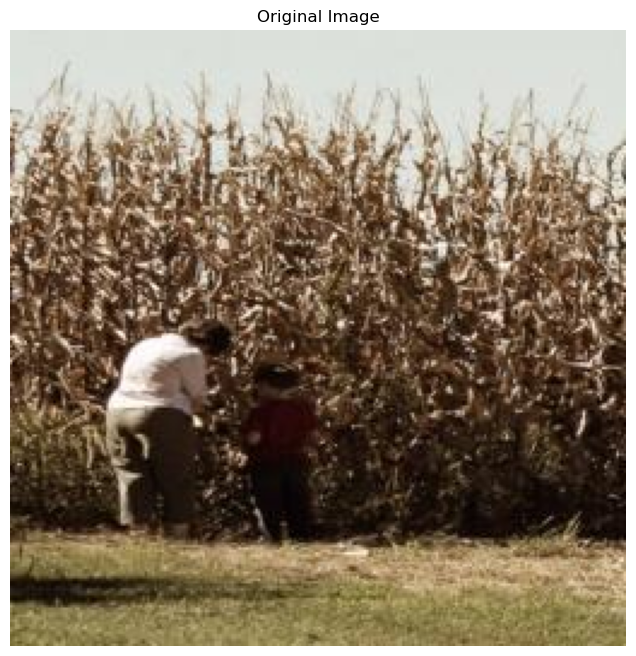

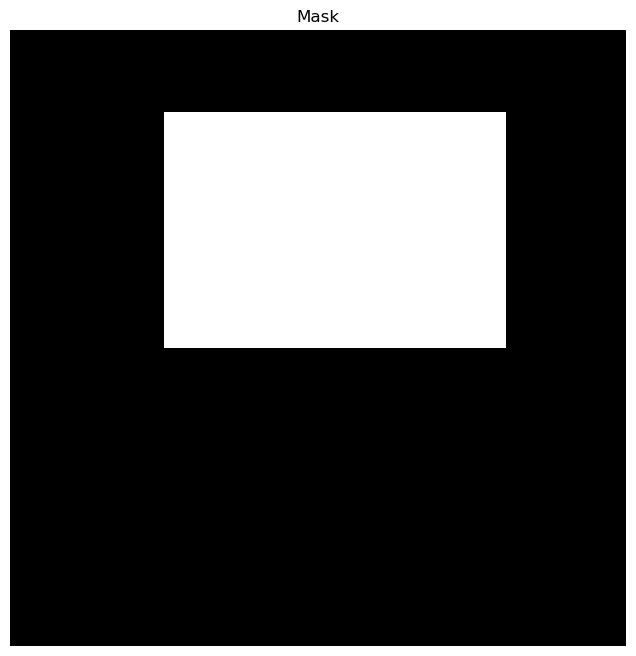

In [6]:
#4
original_img4 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/image_examples/cornfield/00000004.jpg')
mask4 = cv2.imread('C:/Users/minhk/Downloads/Do_An_Computer_Vision/binary_masks/mask_0_49x71.png', 0)

# Hiển thị ảnh gốc (chuyển từ BGR sang RGB vì OpenCV đọc ảnh dạng BGR)
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(original_img4, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')
plt.show()

# Hiển thị ảnh mask
plt.figure(figsize=(10, 8))
plt.imshow(mask4, cmap='gray')
plt.title('Mask')
plt.axis('off')
plt.show()

Navier Stokes: 


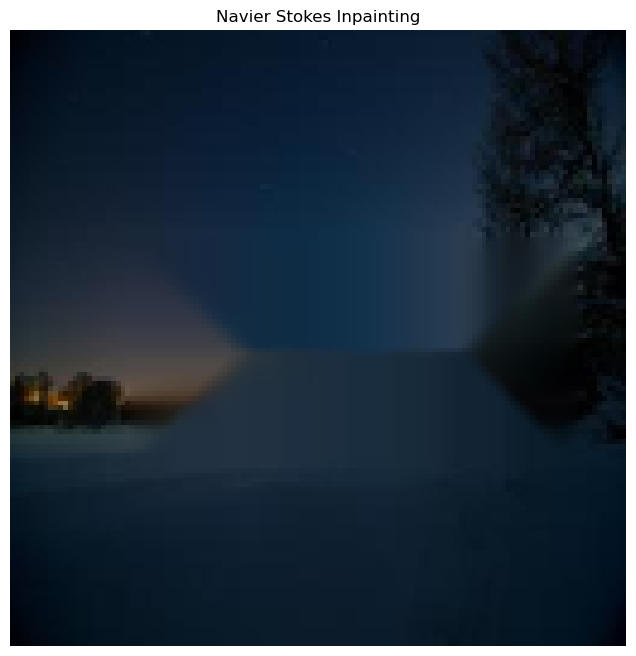


Fast Marching: 


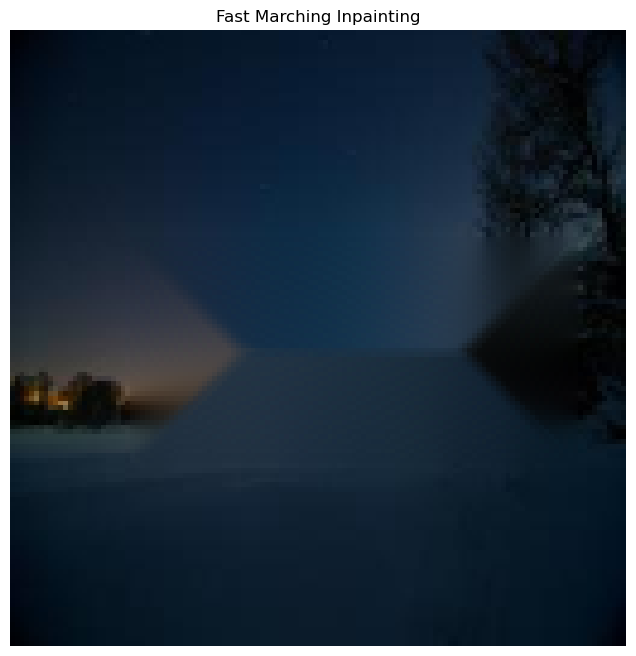

In [7]:
#1
original_img1 = cv2.resize(original_img1, (128, 128))
# Áp dụng thuật toán inpaint
nv_stokes = cv2.inpaint(original_img1, mask1, 3, cv2.INPAINT_NS)
fm = cv2.inpaint(original_img1, mask1, 3, cv2.INPAINT_TELEA)

# Hiển thị kết quả Navier Stokes
print("Navier Stokes: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(nv_stokes, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Navier Stokes Inpainting')
plt.axis('off')
plt.show()

print()

# Hiển thị kết quả Fast Marching
print("Fast Marching: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(fm, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Fast Marching Inpainting')
plt.axis('off')
plt.show()

Navier Stokes: 


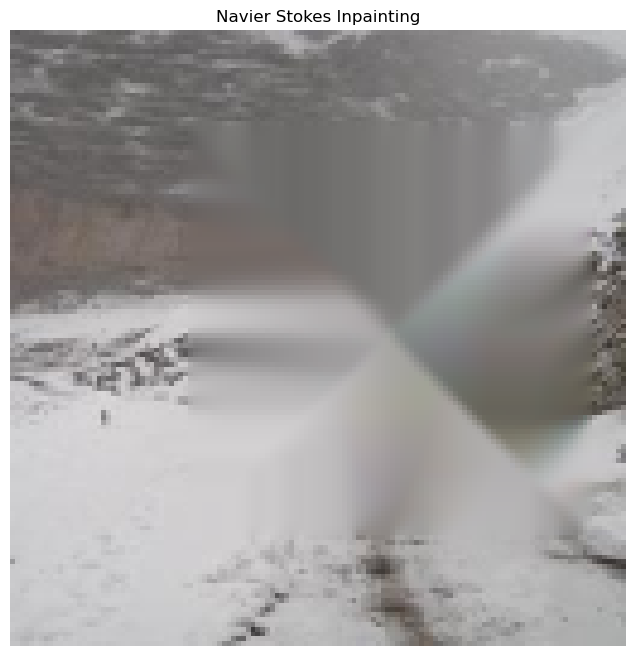


Fast Marching: 


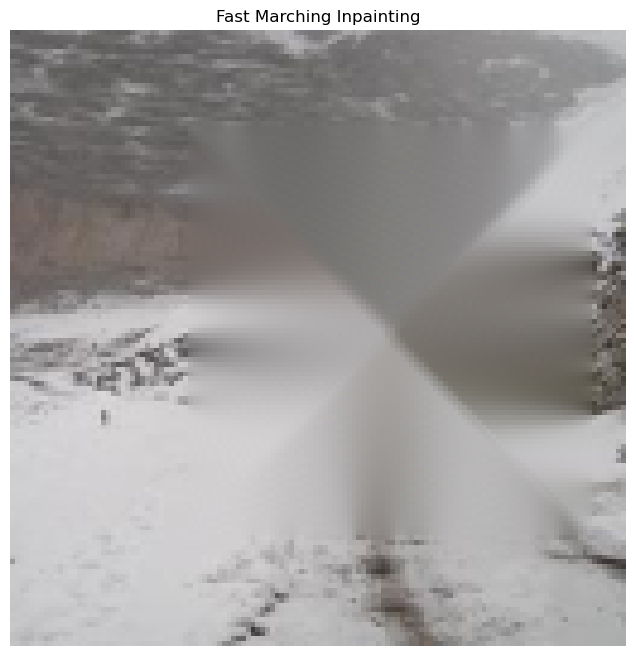

In [8]:
#2
original_img2 = cv2.resize(original_img2, (128, 128))
# Áp dụng thuật toán inpaint
nv_stokes = cv2.inpaint(original_img2, mask2, 3, cv2.INPAINT_NS)
fm = cv2.inpaint(original_img2, mask2, 3, cv2.INPAINT_TELEA)

# Hiển thị kết quả Navier Stokes
print("Navier Stokes: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(nv_stokes, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Navier Stokes Inpainting')
plt.axis('off')
plt.show()

print()

# Hiển thị kết quả Fast Marching
print("Fast Marching: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(fm, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Fast Marching Inpainting')
plt.axis('off')
plt.show()

Navier Stokes: 


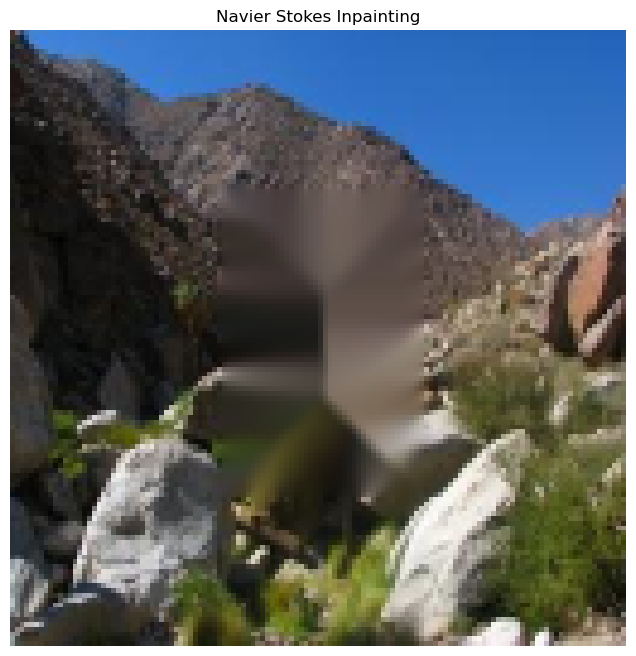


Fast Marching: 


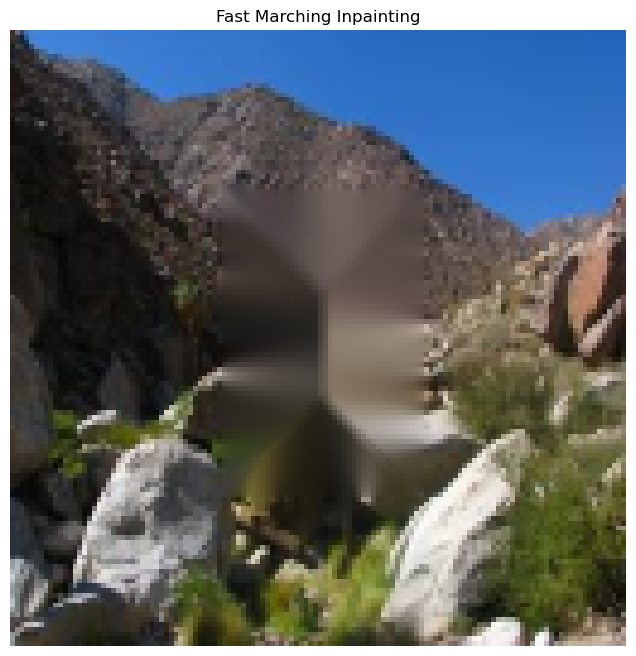

In [9]:
#3
original_img3 = cv2.resize(original_img3, (128, 128))
# Áp dụng thuật toán inpaint
nv_stokes = cv2.inpaint(original_img3, mask3, 3, cv2.INPAINT_NS)
fm = cv2.inpaint(original_img3, mask3, 3, cv2.INPAINT_TELEA)

# Hiển thị kết quả Navier Stokes
print("Navier Stokes: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(nv_stokes, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Navier Stokes Inpainting')
plt.axis('off')
plt.show()

print()

# Hiển thị kết quả Fast Marching
print("Fast Marching: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(fm, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Fast Marching Inpainting')
plt.axis('off')
plt.show()

Navier Stokes: 


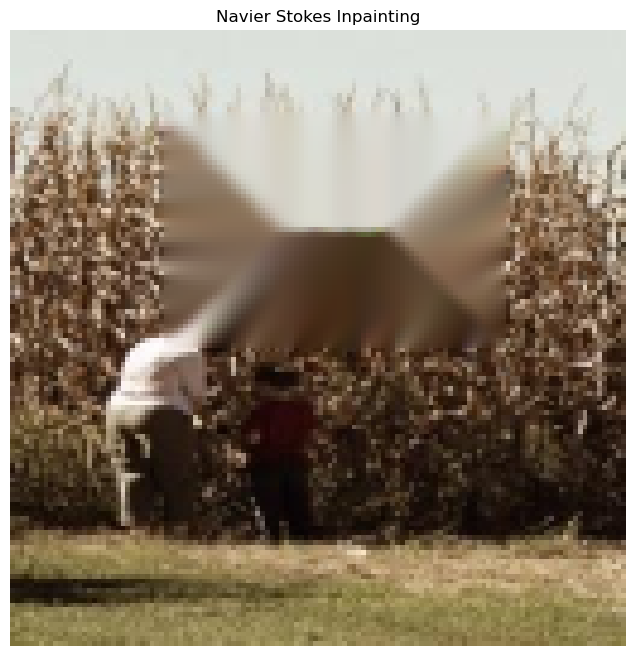


Fast Marching: 


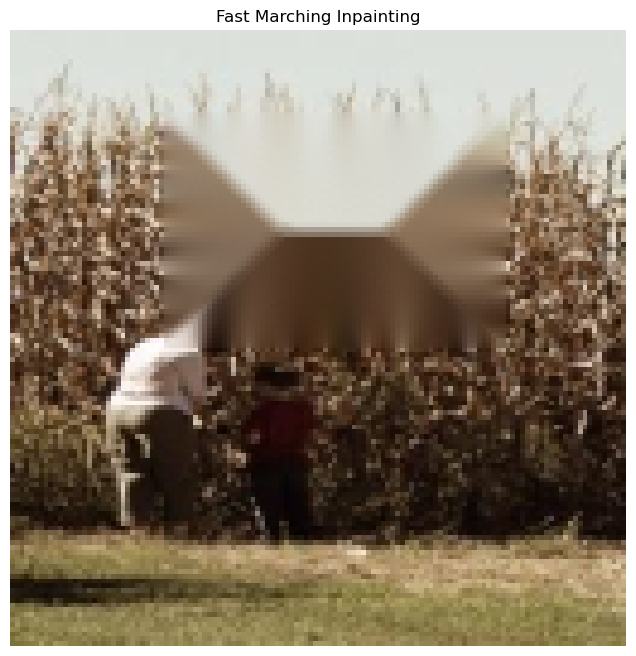

In [10]:
#4
original_img4 = cv2.resize(original_img4, (128, 128))
# Áp dụng thuật toán inpaint
nv_stokes = cv2.inpaint(original_img4, mask4, 3, cv2.INPAINT_NS)
fm = cv2.inpaint(original_img4, mask4, 3, cv2.INPAINT_TELEA)

# Hiển thị kết quả Navier Stokes
print("Navier Stokes: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(nv_stokes, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Navier Stokes Inpainting')
plt.axis('off')
plt.show()

print()

# Hiển thị kết quả Fast Marching
print("Fast Marching: ")
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(fm, cv2.COLOR_BGR2RGB))  # Chuyển BGR sang RGB
plt.title('Fast Marching Inpainting')
plt.axis('off')
plt.show()

In [11]:
from scipy.linalg import sqrtm

def fid(inception_model, imgs1, imgs2):

  imgs1_resized = tf.image.resize(imgs1, [256, 256])
  imgs2_resized = tf.image.resize(imgs2, [256, 256])
  # Extract convolutions from inception model
  conv1 = inception_model.predict(imgs1_resized)
  conv2 = inception_model.predict(imgs2_resized)

  # Compute mean & cov
  m1, cov1 = conv1.mean(axis=0), np.cov(conv1, rowvar=False)
  m2, cov2 = conv2.mean(axis=0), np.cov(conv2, rowvar=False)

  # Sum squared difference of means
  ss = np.sum((m1 - m2) ** 2)

  # Square root of cov product
  mean_cov = sqrtm(cov1.dot(cov2))

  # Sanity check for im numbers
  if np.iscomplexobj(mean_cov):
    mean_cov = mean_cov.real

  FID = ss + np.trace(cov1 + cov2 - 2.0 * mean_cov)
  return FID

In [12]:
import os
import cv2
import tensorflow as tf

original_imgs1 = []

# Import all images from dataset and resize to 128x128
count = 0
for filename in os.listdir('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/sky'):
    if count >= 100:
        break
    img_path = os.path.join('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/sky', filename)
    img = cv2.imread(img_path)
    if img is not None:
        img_resized = cv2.resize(img, (128, 128))
        original_imgs1.append(img_resized)
        count += 1

In [13]:
#2
original_imgs2 = []

# Import all images from dataset and resize to 128x128
count = 0
for filename in os.listdir('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/snowfield'):
    if count >= 100:
        break
    img_path = os.path.join('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/snowfield', filename)
    img = cv2.imread(img_path)
    if img is not None:
        img_resized = cv2.resize(img, (128, 128))
        original_imgs2.append(img_resized)
        count += 1

In [14]:
#3
original_imgs3 = []

# Import all images from dataset and resize to 128x128
count = 0
for filename in os.listdir('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/mountain'):
    if count >= 100:
        break
    img_path = os.path.join('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/mountain', filename)
    img = cv2.imread(img_path)
    if img is not None:
        img_resized = cv2.resize(img, (128, 128))
        original_imgs3.append(img_resized)
        count += 1

In [15]:
#4
original_imgs4 = []

# Import all images from dataset and resize to 128x128
count = 0
for filename in os.listdir('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/corn_field'):
    if count >= 100:
        break
    img_path = os.path.join('C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset/corn_field', filename)
    img = cv2.imread(img_path)
    if img is not None:
        img_resized = cv2.resize(img, (128, 128))
        original_imgs4.append(img_resized)
        count += 1

In [16]:
# Compute analytical inpaints for all images
nv_imgs1 = []
nv_imgs2 = []
nv_imgs3 = []
nv_imgs4 = []
fm_imgs1 = []
fm_imgs2 = []
fm_imgs3 = []
fm_imgs4 = []

for im1 in original_imgs1:
  nv_imgs1.append(cv2.inpaint(im1, mask1, 3, cv2.INPAINT_NS))
  fm_imgs1.append(cv2.inpaint(im1, mask1, 3, cv2.INPAINT_TELEA))

for im2 in original_imgs2:
  nv_imgs2.append(cv2.inpaint(im2, mask2, 3, cv2.INPAINT_NS))
  fm_imgs2.append(cv2.inpaint(im2, mask2, 3, cv2.INPAINT_TELEA))

for im3 in original_imgs3:
  nv_imgs3.append(cv2.inpaint(im3, mask3, 3, cv2.INPAINT_NS))
  fm_imgs3.append(cv2.inpaint(im3, mask3, 3, cv2.INPAINT_TELEA))

for im4 in original_imgs4:
  nv_imgs4.append(cv2.inpaint(im4, mask4, 3, cv2.INPAINT_NS))
  fm_imgs4.append(cv2.inpaint(im4, mask4, 3, cv2.INPAINT_TELEA))

In [17]:
# Convert to np arrays
original_imgs1 = np.array(original_imgs1)
nv_imgs1 = np.array(nv_imgs1)
fm_imgs1 = np.array(fm_imgs1)
original_imgs2 = np.array(original_imgs2)
nv_imgs2 = np.array(nv_imgs2)
fm_imgs2 = np.array(fm_imgs2)
original_imgs3 = np.array(original_imgs3)
nv_imgs3 = np.array(nv_imgs3)
fm_imgs3 = np.array(fm_imgs3)
original_imgs4 = np.array(original_imgs4)
nv_imgs4 = np.array(nv_imgs4)
fm_imgs4 = np.array(fm_imgs4)

# Define the inception model
model = tf.keras.applications.inception_v3.InceptionV3(include_top=False, pooling='avg', input_shape = (256,256,3))

In [18]:
# Preprocess input
original_imgs1 = tf.keras.applications.inception_v3.preprocess_input(original_imgs1)
nv_imgs1 = tf.keras.applications.inception_v3.preprocess_input(nv_imgs1)
fm_imgs1 = tf.keras.applications.inception_v3.preprocess_input(fm_imgs1)
original_imgs2 = tf.keras.applications.inception_v3.preprocess_input(original_imgs2)
nv_imgs2 = tf.keras.applications.inception_v3.preprocess_input(nv_imgs2)
fm_imgs2 = tf.keras.applications.inception_v3.preprocess_input(fm_imgs2)
original_imgs3 = tf.keras.applications.inception_v3.preprocess_input(original_imgs3)
nv_imgs3 = tf.keras.applications.inception_v3.preprocess_input(nv_imgs3)
fm_imgs3 = tf.keras.applications.inception_v3.preprocess_input(fm_imgs3)
original_imgs4 = tf.keras.applications.inception_v3.preprocess_input(original_imgs4)
nv_imgs4 = tf.keras.applications.inception_v3.preprocess_input(nv_imgs4)
fm_imgs4 = tf.keras.applications.inception_v3.preprocess_input(fm_imgs4)

In [19]:
# Compute FID's
#1
nv_fid1 = fid(model, original_imgs1, nv_imgs1)
fm_fid1 = fid(model, original_imgs1, fm_imgs1)

print("Navier Stokes FID:", nv_fid1)
print("Fast Marching FID:", fm_fid1)

4/4 [==============================] - 2s 427ms/step
Navier Stokes FID: 224.53673747288815
Fast Marching FID: 219.64005352022753


In [20]:
#2
nv_fid2 = fid(model, original_imgs2, nv_imgs2)
fm_fid2 = fid(model, original_imgs2, fm_imgs2)

print("Navier Stokes FID:", nv_fid2)
print("Fast Marching FID:", fm_fid2)

4/4 [==============================] - 2s 446ms/step
Navier Stokes FID: 308.25724754067517
Fast Marching FID: 324.8503176060482


In [21]:
#3
nv_fid3 = fid(model, original_imgs3, nv_imgs3)
fm_fid3 = fid(model, original_imgs3, fm_imgs3)

print("Navier Stokes FID:", nv_fid3)
print("Fast Marching FID:", fm_fid3)

4/4 [==============================] - 2s 402ms/step
Navier Stokes FID: 191.8286981082482
Fast Marching FID: 199.82413809085512


In [22]:
#4
nv_fid4 = fid(model, original_imgs4, nv_imgs4)
fm_fid4 = fid(model, original_imgs4, fm_imgs4)

print("Navier Stokes FID:", nv_fid4)
print("Fast Marching FID:", fm_fid4)

4/4 [==============================] - 2s 465ms/step
Navier Stokes FID: 235.7147209676824
Fast Marching FID: 250.12798401055386


In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch.nn.functional as F

In [2]:
# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [3]:
# Root directory for dataset
dataroot = "C:/Users/minhk/Downloads/Do_An_Computer_Vision/dataset"

# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
# size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Weight between various components of total generator loss
weightRecon = 0.99

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

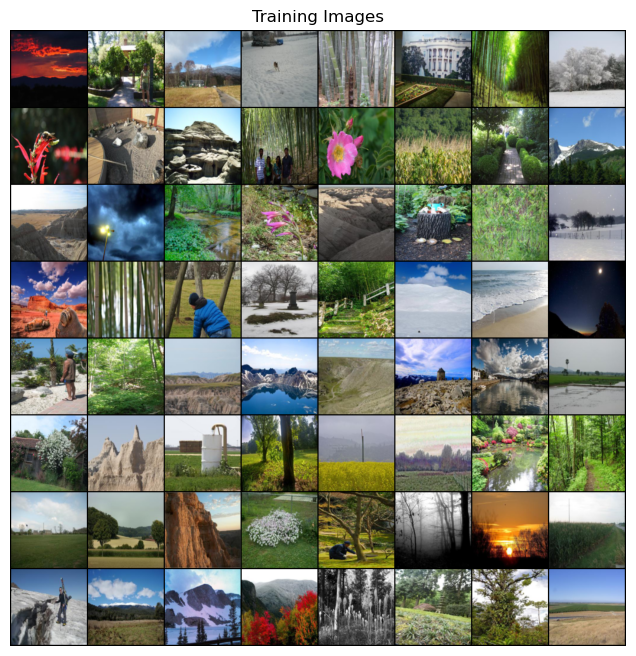

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

# Try other datasets below:

# dataset = dset.MNIST(root=dataroot, train=True, transform=transforms.Compose([
#                                transforms.Resize(image_size),
#                                transforms.CenterCrop(image_size),
#                                transforms.ToTensor(),
#                                transforms.Normalize((0.5), (0.5)),
#                            ]), download=True)
# nc = 1

# dataset = dset.Places365(root=dataroot, split='train-standard', small=True, transform=transforms.Compose([
#                                transforms.Resize(image_size),
#                                transforms.CenterCrop(image_size),
#                                transforms.ToTensor(),
#                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
#                            ]), download=True)


# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
# Generator Code -> generate a 64x64 mask from a 128x128 image
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(in_channels=3,out_channels=64,kernel_size=(4,4),stride=2,padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            #128 images
            nn.Conv2d(in_channels=64,out_channels=64,kernel_size=(4,4),stride=2,padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=64,out_channels=128,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=128,out_channels=256,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=256,out_channels=512,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(512,2048,kernel_size=(4,4)),#bottleneck
            
            # Decoder Part
            
            nn.BatchNorm2d(2048),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.ConvTranspose2d(in_channels=2048,out_channels=512,kernel_size=(4,4),stride=1,padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=512,out_channels=256,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=256,out_channels=128,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            
            # outputting 32x32 here
            
            nn.ConvTranspose2d(in_channels=128,out_channels=64,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            
            #outputting 64x64 here
            
            # nn.ConvTranspose2d(in_channels=64,out_channels=64,kernel_size=(4,4),stride=2,padding=1),
            # nn.BatchNorm2d(64),
            # nn.ReLU(),
            
            # outputting 128x128 here
            
            nn.ConvTranspose2d(in_channels=64,out_channels=3,kernel_size=(4,4),stride=2,padding=1, bias=False),
            nn.Tanh(),
            
        )
        
    def forward(self, input):
        return self.main(input)

In [7]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
# to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (12): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_st

In [8]:
# Discriminator for 64x64 mask
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(in_channels=3,out_channels=64,kernel_size=(4,4),stride=2,padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            
            ## uncomment to import 128x128 masks
            # nn.Conv2d(in_channels=64,out_channels=64,kernel_size=(4,4),stride=2,padding=1),
            # nn.BatchNorm2d(64),
            # nn.LeakyReLU(0.2,in_place=True),
            
            nn.Conv2d(in_channels=64,out_channels=128,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=128,out_channels=256,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=256,out_channels=512,kernel_size=(4,4),stride=2,padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(in_channels=512,out_channels=1,kernel_size=(4,4), bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, input):
        return self.main(input)

In [9]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
# to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [10]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
# the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [11]:
def get_random_block_mask(samples: torch.Tensor, min_size: int = 32, max_size: int = 64):
    B, C, H, W = samples.size()
    # Clone images to apply the mask
    masked_samples = samples.clone()
    
    # Save mask information
    mask_info = []  # To save [top, left, mask_h, mask_w] for each image
    
    for i in range(B):
        # Choose random size for mask
        mask_h = random.randint(min_size, min(max_size, H))
        mask_w = random.randint(min_size, min(max_size, W))
        
        # Random top-left corner of the mask, ensuring it stays within image bounds
        top = random.randint(0, H - mask_h)
        left = random.randint(0, W - mask_w)
        
        # Fill mask area with normalized mean RGB values
        masked_samples[i, 0, top:top+mask_h, left:left+mask_w] = (2 * 117.0 / 255.0 - 1.0)
        masked_samples[i, 1, top:top+mask_h, left:left+mask_w] = (2 * 104.0 / 255.0 - 1.0)
        masked_samples[i, 2, top:top+mask_h, left:left+mask_w] = (2 * 123.0 / 255.0 - 1.0)
        
        # Save mask information
        mask_info.append((top, left, mask_h, mask_w))
    
    # Create list of masked parts to return
    true_masked_parts = []
    for i, (top, left, mask_h, mask_w) in enumerate(mask_info):
        true_part = samples[i, :, top:top+mask_h, left:left+mask_w]
        # Resize to 64x64 for the generator output
        true_part_resized = F.interpolate(true_part.unsqueeze(0), size=(64, 64), mode='bilinear', align_corners=False).squeeze(0)
        true_masked_parts.append(true_part_resized)
    
    return masked_samples, torch.stack(true_masked_parts), mask_info

In [12]:
def get_weights(prediction_size: torch.Size):
    loss_weights = torch.ones(prediction_size)
    return loss_weights

def weighted_mse_loss(outputs, targets, weights):
    return torch.mean(weights * (outputs - targets).pow(2))

In [13]:
# For training visualization purposes
viz_masked_samples, viz_true_masked_part, viz_mask_info = get_random_block_mask(real_batch[0].to(device))

In [14]:
# Training Loop
# Lists to keep track of progress
img_list = []
G_losses = []
G_mse_losses = []
G_Tot_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        
        masked_samples, true_masked_tensor, mask_info = get_random_block_mask(real_cpu)
        
        # Forward pass real batch through D
        output = netD(true_masked_tensor).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()
        
        ## Train with all-fake batch
        # Generate fake image batch with G
        fake = netG(masked_samples)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        D_G_z2 = output.mean().item()
        
        # Add MSE loss between generated infill and original
        l2_weights = get_weights(fake.size())
        lossGeneratorRecon = weighted_mse_loss(fake, true_masked_tensor, l2_weights.to(device))
        lossGeneratorTotal = (1 - weightRecon) * errG + weightRecon * lossGeneratorRecon
        
        lossGeneratorTotal.backward()
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
            
            # Save Losses for plotting later
            G_losses.append(errG.item())
            G_mse_losses.append(lossGeneratorRecon.item())
            G_Tot_losses.append(lossGeneratorTotal.item())
            D_losses.append(errD.item())
        
        
        # Check how the generator is doing by saving G's output on fixed examples
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(viz_masked_samples).detach()
                viz_infill = viz_masked_samples.clone()
                
                # Correctly apply the generated content to the masked areas
                # We need to resize the 64x64 outputs to match the original mask sizes
                for idx, (top, left, mask_h, mask_w) in enumerate(viz_mask_info):
                    if idx < fake.size(0):  # Make sure we don't exceed batch size
                        # Resize the generated 64x64 patch to the actual mask size
                        resized_fake = F.interpolate(
                            fake[idx].unsqueeze(0), 
                            size=(mask_h, mask_w), 
                            mode='bilinear', 
                            align_corners=False
                        )
                        
                        # Place the resized content into the correct position
                        viz_infill[idx, :, top:top+mask_h, left:left+mask_w] = resized_fake.squeeze(0)
                
            img_list.append(vutils.make_grid(viz_infill[:64].cpu(), padding=2, normalize=True))
        
        iters += 1

Starting Training Loop...
[0/100][0/782]	Loss_D: 2.4102	Loss_G: 9.1719	D(x): 0.7059	D(G(z)): 0.8317 / 0.0002
[0/100][50/782]	Loss_D: 0.4354	Loss_G: 3.8971	D(x): 0.7822	D(G(z)): 0.0856 / 0.0328
[0/100][100/782]	Loss_D: 1.0470	Loss_G: 4.4850	D(x): 0.9281	D(G(z)): 0.5970 / 0.0148
[0/100][150/782]	Loss_D: 2.2690	Loss_G: 5.4655	D(x): 0.9808	D(G(z)): 0.8677 / 0.0084
[0/100][200/782]	Loss_D: 0.8030	Loss_G: 3.5099	D(x): 0.8159	D(G(z)): 0.4121 / 0.0397
[0/100][250/782]	Loss_D: 0.8191	Loss_G: 4.4858	D(x): 0.8436	D(G(z)): 0.4081 / 0.0137
[0/100][300/782]	Loss_D: 0.5890	Loss_G: 2.4949	D(x): 0.7680	D(G(z)): 0.2473 / 0.1041
[0/100][350/782]	Loss_D: 1.1091	Loss_G: 2.5562	D(x): 0.6475	D(G(z)): 0.4090 / 0.1160
[0/100][400/782]	Loss_D: 1.2459	Loss_G: 1.2859	D(x): 0.4140	D(G(z)): 0.1766 / 0.3242
[0/100][450/782]	Loss_D: 1.1272	Loss_G: 1.0015	D(x): 0.4863	D(G(z)): 0.2636 / 0.4067
[0/100][500/782]	Loss_D: 1.0495	Loss_G: 1.8356	D(x): 0.4383	D(G(z)): 0.0910 / 0.2182
[0/100][550/782]	Loss_D: 0.4712	Loss_G: 3.

In [15]:
# Save GAN
torch.save({
    "epoch": epoch,
    "state_dict_G": netG.state_dict(),
    "state_dict_D": netD.state_dict(),
    "optimizer_G": optimizerG.state_dict(),
    "optimizer_D": optimizerD.state_dict(),
    "img_list": img_list,
    "G_losses": G_losses,
    "G_mse_losses": G_mse_losses,
    "G_Tot_losses": G_Tot_losses,
    "D_losses": D_losses
}, 'C:/Users/minhk/Downloads/Do_An_Computer_Vision/Models/INFILL_RANDOM_MASK.pth')

In [16]:
# Load GAN for inference
def load_model():
    # Load the generator from saved checkpoint
    netG = Generator(ngpu).to(device)
    checkpoint = torch.load('C:/Users/minhk/Downloads/Do_An_Computer_Vision/Models/INFILL_RANDOM_MASK.pth')
    netG.load_state_dict(checkpoint['state_dict_G'])
    netG.eval()
    
    # Load other saved data
    img_list = checkpoint['img_list']
    G_losses = checkpoint['G_losses']
    G_mse_losses = checkpoint['G_mse_losses']
    G_Tot_losses = checkpoint['G_Tot_losses']
    D_losses = checkpoint['D_losses']
    
    return netG, G_losses, D_losses, img_list

In [17]:
# Function to apply the model to a test batch
def test_model(netG, test_batch=None):
    # If no test batch is provided, get one from the dataloader
    if test_batch is None:
        test_batch = next(iter(dataloader))[0].to(device)
    
    # Create random masks on the test batch
    masked_samples, true_masked_parts, mask_info = get_random_block_mask(test_batch)
    
    with torch.no_grad():
        # Generate infill content
        fake = netG(masked_samples).detach()
        infilled_images = masked_samples.clone()
        
        # Correctly apply the generated content to the masked areas
        for idx, (top, left, mask_h, mask_w) in enumerate(mask_info):
            if idx < fake.size(0):  # Make sure we don't exceed batch size
                # Resize the generated 64x64 patch to the actual mask size
                resized_fake = F.interpolate(
                    fake[idx].unsqueeze(0), 
                    size=(mask_h, mask_w), 
                    mode='bilinear', 
                    align_corners=False
                )
                
                # Place the resized content into the correct position
                infilled_images[idx, :, top:top+mask_h, left:left+mask_w] = resized_fake.squeeze(0)
    
    return test_batch, masked_samples, infilled_images, mask_info

# Uncomment to load and test the model
netG, G_losses, D_losses, img_list = load_model()
test_batch, masked_samples, infilled_images, mask_info = test_model(netG)

C:\Users\minhk\AppData\Local\Temp\ipykernel_11028\1370997649.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('C:/Users/minhk/Downloads/Do_An_Comp

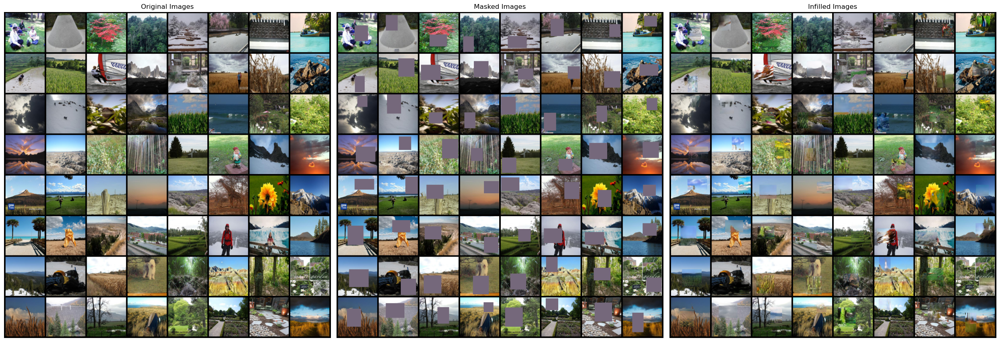

In [18]:
# Example of how to visualize the results
def visualize_results(test_batch, masked_samples, infilled_images, num_images=64):
    plt.figure(figsize=(25, 25))
    
    # Plot original images
    plt.subplot(1, 3, 1)
    plt.axis("off")
    plt.title("Original Images")
    plt.imshow(np.transpose(vutils.make_grid(test_batch[:num_images].cpu(), padding=5, normalize=True), (1, 2, 0)))
    
    # Plot masked images
    plt.subplot(1, 3, 2)
    plt.axis("off")
    plt.title("Masked Images")
    plt.imshow(np.transpose(vutils.make_grid(masked_samples[:num_images].cpu(), padding=5, normalize=True), (1, 2, 0)))
    
    # Plot infilled images
    plt.subplot(1, 3, 3)
    plt.axis("off")
    plt.title("Infilled Images")
    plt.imshow(np.transpose(vutils.make_grid(infilled_images[:num_images].cpu(), padding=5, normalize=True), (1, 2, 0)))
    
    plt.tight_layout()
    plt.show()

# Uncomment to visualize the results
visualize_results(test_batch, masked_samples, infilled_images)

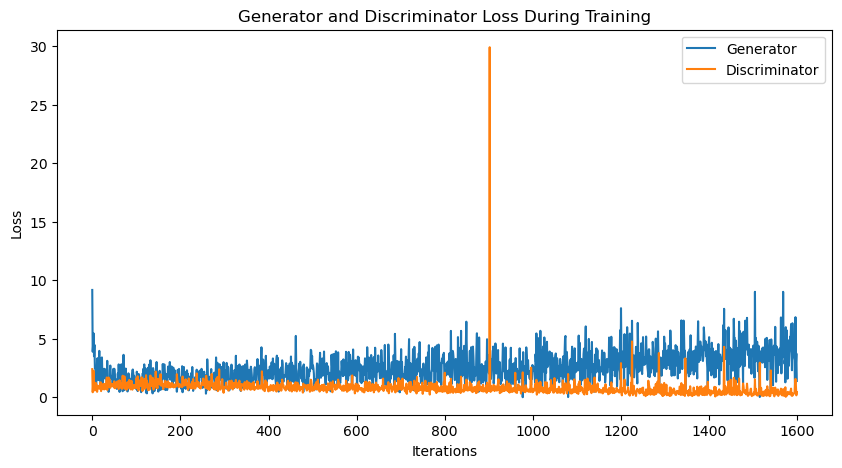

In [19]:
# Plot training losses
def plot_losses(G_losses, D_losses):
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(G_losses, label="Generator")
    plt.plot(D_losses, label="Discriminator")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

# Uncomment to plot losses
plot_losses(G_losses, D_losses)

Animation size has reached 21660704 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


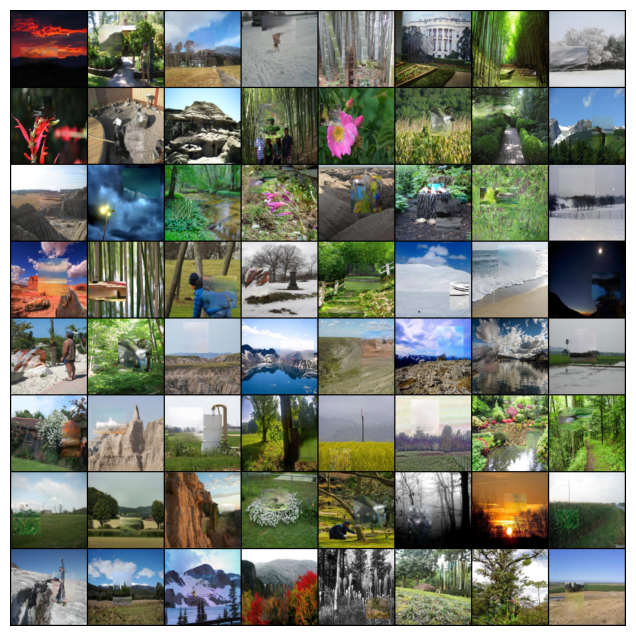

In [20]:
# Create animation of training progress
def create_training_animation(img_list):
    fig = plt.figure(figsize=(8,8))
    plt.axis("off")
    ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
    ani = animation.ArtistAnimation(fig, ims, interval=200, repeat_delay=1000, blit=True)
    return HTML(ani.to_jshtml())

# Uncomment to create animation
create_training_animation(img_list)

In [33]:
import torch
import numpy as np
from scipy.linalg import sqrtm
from torchvision.models import inception_v3, Inception_V3_Weights
import torch.nn.functional as F

# =======================
# PSNR (Peak Signal-to-Noise Ratio)
# =======================
def compute_psnr(img1, img2, max_pixel=1.0):
    # img1, img2: shape (N, C, H, W), pixel value in [-1, 1] or [0, 1]
    # First, map to [0, 1]
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2
    mse = torch.mean((img1 - img2) ** 2, dim=[1,2,3])
    psnr = 10 * torch.log10(max_pixel ** 2 / (mse + 1e-8))
    return psnr.mean().item()

# =======================
# MAE (Mean Absolute Error)
# =======================
def compute_mae(img1, img2):
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2
    mae = torch.mean(torch.abs(img1 - img2), dim=[1,2,3])
    return mae.mean().item()

# =======================
# RMSE (Root Mean Squared Error)
# =======================
def compute_rmse(img1, img2):
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2
    mse = torch.mean((img1 - img2) ** 2, dim=[1,2,3])
    rmse = torch.sqrt(mse)
    return rmse.mean().item()

# =======================
# SSIM (Structural Similarity Index, simplified, manual)
# =======================
def compute_ssim(img1, img2, window_size=11, C1=0.01**2, C2=0.03**2):
    # Only for grayscale or per-channel
    # img1, img2: (N, C, H, W) in [0, 1]
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2

    N, C, H, W = img1.shape
    # Compute mean
    mu1 = torch.mean(img1, dim=[2,3], keepdim=True)
    mu2 = torch.mean(img2, dim=[2,3], keepdim=True)
    # Compute variance
    sigma1_sq = torch.mean((img1 - mu1) ** 2, dim=[2,3], keepdim=True)
    sigma2_sq = torch.mean((img2 - mu2) ** 2, dim=[2,3], keepdim=True)
    # Compute covariance
    sigma12 = torch.mean((img1 - mu1) * (img2 - mu2), dim=[2,3], keepdim=True)

    ssim_map = ((2 * mu1 * mu2 + C1) * (2 * sigma12 + C2)) / \
               ((mu1 ** 2 + mu2 ** 2 + C1) * (sigma1_sq + sigma2_sq + C2))
    return ssim_map.mean().item()

# =======================
# LPIPS (Learned Perceptual Image Patch Similarity, simplified, manual, color distance)
# =======================
def compute_lpips_like(img1, img2):
    # Not true LPIPS (needs a deep network), but a color-perceptual diff
    # We'll compute mean L2 distance in feature space (just color here)
    img1 = (img1 + 1) / 2 if img1.min() < 0 else img1
    img2 = (img2 + 1) / 2 if img2.min() < 0 else img2
    diff = torch.mean((img1 - img2) ** 2, dim=1)  # per image, per pixel
    return diff.mean().item()


# =======================
# FID (Fréchet Inception Distance, manual, no pretrained network)
# =======================
# Trích xuất feature từ inception v3
def get_inception_features(images, inception_model, device, batch_size=32):
    # images: (N, C, H, W) torch.Tensor, trong [0, 1] hoặc [-1, 1]
    if images.min() < 0:
        images = (images + 1) / 2
    # Resize về 299x299 (InceptionV3 input)
    images = F.interpolate(images, size=(299, 299), mode="bilinear", align_corners=False)
    feats = []
    inception_model.eval()
    with torch.no_grad():
        for i in range(0, images.size(0), batch_size):
            batch = images[i:i+batch_size].to(device)
            pred = inception_model(batch)
            feats.append(pred.cpu().numpy())
    feats = np.concatenate(feats, axis=0)
    return feats

# FID chuẩn qua inception features
def compute_fid_inception(real_imgs, fake_imgs, device="cuda", batch_size=32):
    # Chuẩn bị inception model (pooling output)
    weights = Inception_V3_Weights.DEFAULT
    inception = inception_v3(weights=weights, transform_input=False)
    inception.fc = torch.nn.Identity()  # bỏ fully connected cho feature 2048d
    inception = inception.to(device)
    inception.eval()
    
    # Lấy feature
    feats_real = get_inception_features(real_imgs, inception, device, batch_size)
    feats_fake = get_inception_features(fake_imgs, inception, device, batch_size)

    # Tính mean, cov
    m1, c1 = feats_real.mean(axis=0), np.cov(feats_real, rowvar=False)
    m2, c2 = feats_fake.mean(axis=0), np.cov(feats_fake, rowvar=False)
    ss = np.sum((m1 - m2) ** 2)
    covmean = sqrtm(c1.dot(c2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid = ss + np.trace(c1 + c2 - 2.0 * covmean)
    return float(fid)

# =======================
# Evaluator function: use all metrics
# =======================
def evaluate_images(recon_images, gt_images):
    """
    recon_images, gt_images: torch.Tensor shape (N, C, H, W), [-1, 1] or [0, 1]
    """
    psnr = compute_psnr(recon_images, gt_images)
    mae = compute_mae(recon_images, gt_images)
    rmse = compute_rmse(recon_images, gt_images)
    ssim = compute_ssim(recon_images, gt_images)
    lpips_like = compute_lpips_like(recon_images, gt_images)
    fid = compute_fid_inception(gt_images, recon_images, device=device, batch_size=16)
    return {
        "PSNR": psnr,
        "MAE": mae,
        "RMSE": rmse,
        "SSIM (mean)": ssim,
        "LPIPS-like": lpips_like,
        "FID": fid
    }

# =======================
# Example Usage
# =======================
if __name__ == "__main__":
    # Assume you have test_batch, infilled_images from your main code:
    test_batch, masked_samples, infilled_images, mask_info = test_model(netG)
    # For full image evaluation:
    metrics = evaluate_images(infilled_images, test_batch)
    print(metrics)

{'PSNR': 25.2313289642334, 'MAE': 0.016639133915305138, 'RMSE': 0.05856496840715408, 'SSIM (mean)': 0.9485851526260376, 'LPIPS-like': 0.003841802477836609, 'FID': 55.2434275645018}


Image tensor shape: torch.Size([1, 3, 128, 128])


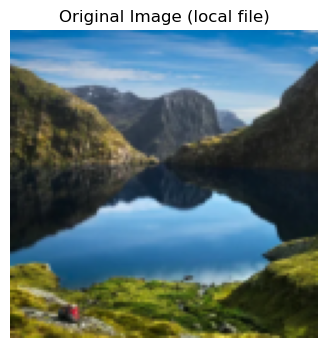

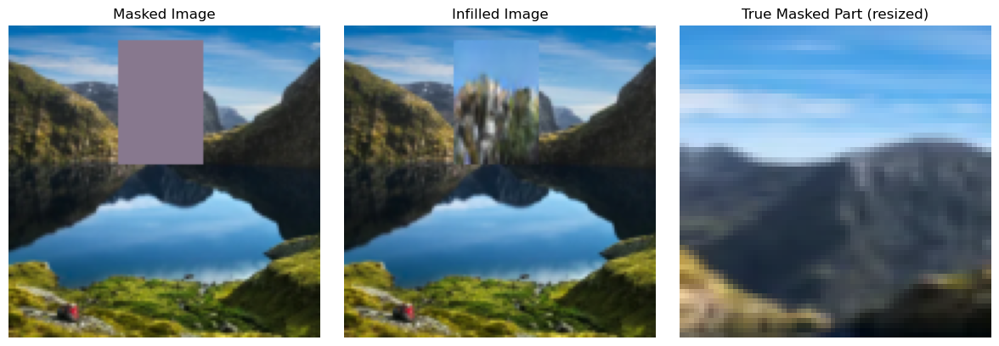

(tensor([[[[-0.9608, -0.9529, -0.9451,  ...,  0.0196,  0.0039, -0.0745],
           [-0.9922, -0.9922, -0.9922,  ..., -0.5373, -0.5686, -0.6078],
           [-0.9922, -0.9843, -0.9843,  ..., -0.7725, -0.7412, -0.6235],
           ...,
           [-0.0039, -0.0275, -0.0824,  ..., -0.6627, -0.6941, -0.6784],
           [-0.3882, -0.3490, -0.2471,  ..., -0.7176, -0.7412, -0.7020],
           [-0.2627, -0.3020, -0.2000,  ..., -0.6392, -0.7255, -0.7569]],
 
          [[-0.2706, -0.2627, -0.2706,  ...,  0.2157,  0.2078,  0.1608],
           [-0.2863, -0.2863, -0.2784,  ..., -0.0824, -0.0980, -0.1216],
           [-0.2627, -0.2627, -0.2706,  ..., -0.1608, -0.1451, -0.1059],
           ...,
           [-0.1451, -0.1451, -0.2000,  ..., -0.6157, -0.6627, -0.6549],
           [-0.4980, -0.4431, -0.3647,  ..., -0.6863, -0.7176, -0.6863],
           [-0.3961, -0.4431, -0.3412,  ..., -0.5922, -0.7020, -0.7412]],
 
          [[ 0.1843,  0.1922,  0.1922,  ...,  0.3725,  0.3882,  0.3804],
           [ 

In [43]:
import PIL
import torch
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import torch.nn.functional as F

def test_custom_image_local(netG, device, image_path, image_size=128):
    """
    Đọc ảnh từ đường dẫn cục bộ, resize, mask, infill và hiển thị kết quả.
    """
    # 1. Đọc ảnh từ file local
    im = PIL.Image.open(image_path).convert('RGB')

    # 2. Transform
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
    im_tensor = transform(im)
    if im_tensor.shape[0] != 3:
        im_tensor = im_tensor[0:3, :, :]
    im_tensor = im_tensor.unsqueeze(0).to(device)
    print("Image tensor shape:", im_tensor.shape)

    # 3. Hiển thị ảnh gốc
    plt.figure(figsize=(4,4))
    plt.axis("off")
    plt.title("Original Image (local file)")
    plt.imshow(np.transpose(vutils.make_grid(im_tensor.cpu(), padding=2, normalize=True), (1,2,0)))
    plt.show()

    # 4. Tạo mask ngẫu nhiên
    test_masked_samples, test_true_masked_part, mask_info = get_random_block_mask(im_tensor)

    # 5. Infill với netG
    netG.eval()
    with torch.no_grad():
        fake = netG(test_masked_samples).detach().cpu()
        viz_infill = test_masked_samples.clone().cpu()
        for idx, (top, left, mask_h, mask_w) in enumerate(mask_info):
            if idx < fake.size(0):
                resized_fake = F.interpolate(
                    fake[idx].unsqueeze(0), 
                    size=(mask_h, mask_w), 
                    mode='bilinear', 
                    align_corners=False
                )
                viz_infill[idx, :, top:top+mask_h, left:left+mask_w] = resized_fake.squeeze(0)

    # 6. Hiển thị kết quả
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.axis("off")
    plt.title("Masked Image")
    plt.imshow(np.transpose(vutils.make_grid(test_masked_samples.cpu(), padding=2, normalize=True), (1,2,0)))

    plt.subplot(1,3,2)
    plt.axis("off")
    plt.title("Infilled Image")
    plt.imshow(np.transpose(vutils.make_grid(viz_infill.cpu(), padding=2, normalize=True), (1,2,0)))

    plt.subplot(1,3,3)
    plt.axis("off")
    plt.title("True Masked Part (resized)")
    plt.imshow(np.transpose(vutils.make_grid(test_true_masked_part.cpu(), padding=2, normalize=True), (1,2,0)))
    plt.tight_layout()
    plt.show()

    return im_tensor, test_masked_samples, viz_infill, test_true_masked_part

image_path = "C:/Users/minhk/Downloads/Do_An_Computer_Vision/image_examples/test.jpg"
test_custom_image_local(netG, device, image_path)